# Statistics with Julia from the ground up
#### A [JuliaCon 2021](https://juliacon.org/2021/) workshop by [Yoni Nazarathy](https://yoninazarathy.com/)

Many of the code examples for this workshop are adapted from [Statistics with Julia:
Fundamentals for Data Science, Machine Learning and Artificial Intelligence by Yoni Nazarathy and Hayden Klok](https://statisticswithjulia.org/).  

Also related (and recommended in this JuliaCon): 
* [Dataframes tutorial](https://github.com/bkamins/JuliaCon2021-DataFrames-Tutorial) or [here](https://pretalx.com/juliacon2021/talk/FXZXMB/) by Bogumił Kamiński.
* [Introduction to Bayesian Data Analysis](https://pretalx.com/juliacon2021/talk/J7BFBM/) by Kusti Skytén.
* Dozens of other very exciting talks...

<a id='home'></a>
# Table of Contents

1. [Why Julia?](#why-julia)
1. [What do you `mean`?](#what-do-you-mean)
1. [Something `rand`.](#something-rand)
1. [Do you still miss R? So Just `RCall`.](#just-rcall)
1. [Some `Plots`.](#some-plots)
1. [Your favorite `Distribution`.](#favorite-distribution)
1. [We love `DataFrames`.](#love-dataframes)
1. [Gotta have some basic inference.](#inference)
1. [Linear models at our core.](#linear-models)
1. [Basic Machine learning.](#basic-ml)


---
## Before we start

The tutorial was developed and tested under Julia 1.6.0. It is best to run it with the `Project.toml` and `Manifest.toml` files present in the working directory of the notebook. It also uses the following data files: 

In [1]:
readdir("./data")

8-element Vector{String}:
 "L1L2data.csv"
 "fertilizer.csv"
 "machine1.csv"
 "machine2.csv"
 "machine3.csv"
 "purchaseData.csv"
 "temperatures.csv"
 "weightHeight.csv"

You will find all these files and this notebook in the [Github repo for this workshop](https://github.com/yoninazarathy/JuliaCon2021-StatisticsWithJuliaFromTheGroundUp). You can either "clone" the repo or download a zip file.

We use a [Jupyter Notebook](https://jupyter.org/). Here is a [quick reference sheet](edureka.co/blog/wp-content/uploads/2018/10/Jupyter_Notebook_CheatSheet_Edureka.pdf). Many other reserouces on the web as well for Jupyter - many of which use Python and not Julia, but Jupyter is the same. BTW the "J" in "Jupyter" is for "Julia".

Load the packages we will use:

In [2]:
using Pkg
Pkg.activate(".")
Pkg.instantiate()

  Activating environment at `~/git/mine/JuliaCon2021-StatisticsWithJuliaFromTheGroundUp/Project.toml`


In [3]:
Pkg.status()

      Status `~/git/mine/JuliaCon2021-StatisticsWithJuliaFromTheGroundUp/Project.toml`
  [336ed68f] CSV v0.8.5
  [aaaa29a8] Clustering v0.14.2
  [861a8166] Combinatorics v1.0.2
  [a93c6f00] DataFrames v1.2.0
  [31c24e10] Distributions v0.25.11
  [587475ba] Flux v0.12.5
  [38e38edf] GLM v1.5.1
  [09f84164] HypothesisTests v0.10.4
  [5ab0869b] KernelDensity v0.6.3
  [b964fa9f] LaTeXStrings v1.2.1
  [b4fcebef] Lasso v0.6.2
  [eb30cadb] MLDatasets v0.5.7
  [442fdcdd] Measures v0.3.1
  [dbeba491] Metalhead v0.5.3
  [6f286f6a] MultivariateStats v0.8.0
  [91a5bcdd] Plots v1.19.2
  [ce6b1742] RDatasets v0.7.5
  [f2b01f46] Roots v1.0.10
  [276daf66] SpecialFunctions v1.5.1
  [2913bbd2] StatsBase v0.33.8
  [f3b207a7] StatsPlots v0.14.25


In [4]:
using Random, Statistics, LinearAlgebra, Dates #Shipped with Julia
using Distributions, StatsBase #Core statistics
using CSV, DataFrames #Basic Data
using Plots, StatsPlots, LaTeXStrings, Measures #Plotting and Output
using HypothesisTests, KernelDensity, GLM, Lasso, Clustering, MultivariateStats #Statistical/ML methods
using Flux, Metalhead #Deep learning 
using Combinatorics, SpecialFunctions, Roots #Mathematical misc.
using RDatasets, MLDatasets #Example datasets
#uncomment if using R:  using RCall #Interface with R

In [5]:
# We run this before many examples for reproducibility
fix_seed!() = Random.seed!(0)

fix_seed! (generic function with 1 method)

<a id='why-julia'></a>

---

# Why Julia?
[home](#home)

![Julia Curve](img/julia_curve.png)

### Some ways to run Julia

* REPL
    - As an application
    - Out of your shell 
    - As part of an IDE
* Jupyter (IJulia)
    - In your web browser
    - Jupyter Lab
* Google collab
* Pluto
* Visual Studio Code
* Legacy: Atom (Juno)
* JuliaHub
* In RMarkdown with IJulia (e.g. in R studio)
* ... 

### Key resources (My favorites)

* Main Julia Page: https://julialang.org/
* Docs: https://docs.julialang.org/
* Julia Express: https://github.com/bkamins/The-Julia-Express 
* Think Julia: https://www.oreilly.com/library/view/think-julia/9781492045021/
* MIT Course, computational thinking: https://computationalthinking.mit.edu/Spring21/ 
* A University of Queensland Course: https://courses.smp.uq.edu.au/MATH2504/
* Statistics with Julia: https://statisticswithjulia.org/ (use image gallary) 
* Package documentation: Searching for the package, e.g. `Plots.jl`, typically gets you to GitHub. From there find the docs.
* Julia Discourse: https://discourse.julialang.org/
* Julia Slack: https://julialang.org/slack/ 
* Your local Julia "club": E.g. in my area: https://www.meetup.com/en-AU/brisbane-julia-language-meetup/ 
* YouTube...


<a id='what-do-you-mean'></a>

---

# What do you `mean`?
[home](#home)

In [6]:
fix_seed!()
data = rand(Normal(),5)

5-element Vector{Float64}:
  0.6791074260357777
  0.8284134829000359
 -0.3530074003005963
 -0.13485387193052173
  0.5866170746331097

In [7]:
n = length(data)

5

In [8]:
sum(data)/n

0.3212553422675611

In [9]:
+(data...)/n

0.3212553422675611

In [ ]:
? +

In [11]:
"""
This is a function that takes in data and returns its sum.
"""
function my_sum(data)
    s = 0.0
    for d in data
        s += d
    end
    return s
end

my_sum

In [12]:
? my_sum

search: my_sum



This is a function that takes in data and returns its sum.


In [13]:
my_sum(data)/length(data)

0.3212553422675611

In [14]:
mean(data)

0.3212553422675611

In [15]:
data'*ones(n)/n

0.3212553422675611

In [16]:
dot(data,ones(n))/n

0.3212553422675611

In [ ]:
? dot

#### Doing it a little differently with the "running mean" formula

$$
\overline{X}_i = \frac{1}{i} X_i + \frac{i-1}{i} \overline{X}_{i-1}.
$$

In [17]:
mn = 0
for i in 1:length(data)
    global mn = (1/i)*data[i] + (i-1)/i*mn
end
mn

0.32125534226756114

In [18]:
mn = 0
for (i,d) in enumerate(data)
    global mn = (1/i)*d + (i-1)/i*mn #Note that in Jupyter `global` isn't needed here but in the REPL it is.
end
mn

0.32125534226756114

In [19]:
function my_mean(data)
    mn = 0
    for (i,d) in enumerate(data)
        mn = (1/i)*d + (i-1)/i*mn
    end
    return mn
end

my_mean (generic function with 1 method)

In [20]:
my_mean(data)

0.32125534226756114

In [21]:
fix_seed!()
data = rand(Normal(),n) + im*rand(Normal(),n)

5-element Vector{ComplexF64}:
   0.6791074260357777 + 0.29733585084941616im
   0.8284134829000359 + 0.06494754854834232im
  -0.3530074003005963 - 0.10901738508171745im
 -0.13485387193052173 - 0.514210390833322im
   0.5866170746331097 + 1.5743302021369892im

In [22]:
mean(data)

0.3212553422675611 + 0.2626771651239416im

In [ ]:
methods(mean)

In [23]:
@which mean(data)

mean(A::AbstractArray; dims) in Statistics at /Applications/Julia-1.6.app/Contents/Resources/julia/share/julia/stdlib/v1.6/Statistics/src/Statistics.jl:164

In [24]:
methods(my_mean)

# 1 method for generic function "my_mean":
[1] my_mean(data) in Main at In[19]:1

In [25]:
function my_mean(data::Vector{Float64})::Float64
    mn = 0.0
    for (i,d) in enumerate(data)
        mn = (1/i)*d + (i-1)/i*mn
    end
    return mn
end

my_mean (generic function with 2 methods)

In [26]:
methods(my_mean)

# 2 methods for generic function "my_mean":
[1] my_mean(data::Vector{Float64}) in Main at In[25]:1
[2] my_mean(data) in Main at In[19]:1

In [27]:
@which my_mean(data)

my_mean(data) in Main at In[19]:1

In [28]:
@which my_mean([1,2])

my_mean(data) in Main at In[19]:1

In [29]:
@which my_mean([1.0,2.0])

my_mean(data::Vector{Float64}) in Main at In[25]:1

In [30]:
@which my_mean([1.0,2])

my_mean(data::Vector{Float64}) in Main at In[25]:1

In [31]:
function my_mean(data::Vector{T})::T where T
    mn = zero(data[begin])
    for (i,d) in enumerate(data)
        mn = (1/i)*d + (i-1)/i*mn
    end
    return mn
end

my_mean (generic function with 3 methods)

In [32]:
methods(my_mean)

# 3 methods for generic function "my_mean":
[1] my_mean(data::Vector{Float64}) in Main at In[25]:1
[2] my_mean(data::Vector{T}) where T in Main at In[31]:1
[3] my_mean(data) in Main at In[19]:1

#### The mean of other types

In [33]:
fix_seed!()
data = [rand(Normal(),2,2) for _ in 1:5]

5-element Vector{Matrix{Float64}}:
 [0.6791074260357777 -0.3530074003005963; 0.8284134829000359 -0.13485387193052173]
 [0.5866170746331097 0.06494754854834232; 0.29733585084941616 -0.10901738508171745]
 [-0.514210390833322 -0.6889071278256981; 1.5743302021369892 -0.7628038164104581]
 [0.39748240921816347 -0.34635460427879816; 0.8116296225068749 -0.18757268194516005]
 [-1.6072563241277753 2.2762328327845243; -2.48079273065994 0.21969346754254096]

In [34]:
mean(data)

2×2 Matrix{Float64}:
 -0.091652   0.190582
  0.206183  -0.194911

In [35]:
my_mean(data)

2×2 Matrix{Float64}:
 -0.091652   0.190582
  0.206183  -0.194911

In [36]:
@which my_mean(data)

my_mean(data::Vector{T}) where T in Main at In[31]:1

#### A glimpse under the hood

In [ ]:
@code_lowered my_mean(data)

In [ ]:
@code_llvm my_mean(data)

In [ ]:
@code_native my_mean(data)

#### An array of arrays

In [38]:
fix_seed!()
data = [rand(Normal(μ,1),5) for μ in 1:5] #\mu + [TAB]

5-element Vector{Vector{Float64}}:
 [1.6791074260357777, 1.8284134829000358, 0.6469925996994037, 0.8651461280694783, 1.5866170746331099]
 [2.297335850849416, 2.0649475485483424, 1.8909826149182825, 1.485789609166678, 3.574330202136989]
 [2.311092872174302, 2.2371961835895418, 3.3974824092181635, 3.811629622506875, 2.6536453957212016]
 [3.81242731805484, 2.3927436758722247, 1.5192072693400598, 6.276232832784524, 4.219693467542541]
 [4.882862469267065, 4.398746405814617, 6.14227643894132, 4.911383681799527, 5.2794662520898985]

In [39]:
mean.(data)

5-element Vector{Float64}:
 1.321255342267561
 2.262677165123942
 2.8822092966420163
 3.644060912718838
 5.122947049582486

#### A matrix of data

In [40]:
data = hcat(data...)

5×5 Matrix{Float64}:
 1.67911   2.29734  2.31109  3.81243  4.88286
 1.82841   2.06495  2.2372   2.39274  4.39875
 0.646993  1.89098  3.39748  1.51921  6.14228
 0.865146  1.48579  3.81163  6.27623  4.91138
 1.58662   3.57433  2.65365  4.21969  5.27947

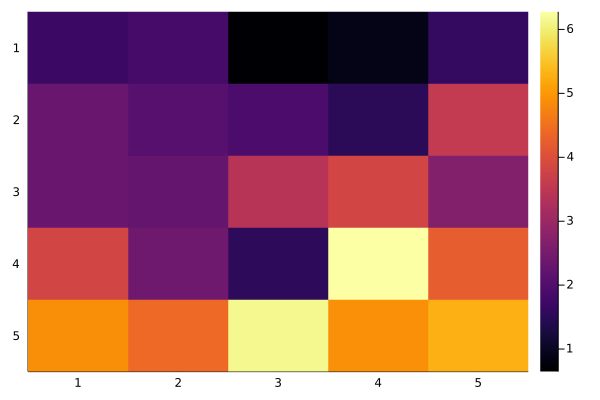

In [41]:
heatmap(data',yflip=true)

In [42]:
mean.(data) #does nothing useful

5×5 Matrix{Float64}:
 1.67911   2.29734  2.31109  3.81243  4.88286
 1.82841   2.06495  2.2372   2.39274  4.39875
 0.646993  1.89098  3.39748  1.51921  6.14228
 0.865146  1.48579  3.81163  6.27623  4.91138
 1.58662   3.57433  2.65365  4.21969  5.27947

In [43]:
mean(data,dims=1) #better!

1×5 Matrix{Float64}:
 1.32126  2.26268  2.88221  3.64406  5.12295

#### Dictionaries

In [44]:
data = Dict()
data[:cats] = rand(Normal(2.3,1),5)
data["dogs"] = rand(Normal(5.2,1),5)
data[25] = rand(Normal(7.8,1),5)
data

Dict{Any, Any} with 3 entries:
  "dogs" => [6.62305, 5.60839, 5.78862, 4.90372, 5.89111]
  25     => [8.30687, 7.74307, 6.02898, 9.39062, 9.19706]
  :cats  => [2.41142, 1.94212, 2.77371, 2.60023, 1.53732]

In [45]:
keys(data)

KeySet for a Dict{Any, Any} with 3 entries. Keys:
  "dogs"
  25
  :cats

In [46]:
mean(data[:cats])

2.2529618709854136

In [47]:
mean(data["dogs"])

5.762977963045932

In [48]:
mean(data["cats"])

LoadError: KeyError: key "cats" not found

In [49]:
mean(data[Symbol("cats")])

2.2529618709854136

In [50]:
data[Symbol("cats")] |> mean

2.2529618709854136

#### Tuples

In [51]:
fix_seed!()
rn() = rand(Normal())
data = (rn(), rn(),rn())

(0.6791074260357777, 0.8284134829000359, -0.3530074003005963)

In [52]:
typeof(data)

Tuple{Float64, Float64, Float64}

In [53]:
mean(data)

0.3848378362117391

In [54]:
data[2]

0.8284134829000359

In [55]:
data[2] = 7.8 #Tuples are immutable! 

LoadError: MethodError: no method matching setindex!(::Tuple{Float64, Float64, Float64}, ::Float64, ::Int64)

#### Structs

In [56]:
struct Person
    weight::Float64
    height::Float64
end

In [57]:
someone = Person(102, 180)

Person(102.0, 180.0)

In [58]:
someone.weight = 103 #Structs are immutable unless you state immutable

LoadError: setfield! immutable struct of type Person cannot be changed

In [59]:
me = Person(102, 180)
you = Person(83, 170)
me + you #can't add persons just like that

LoadError: MethodError: no method matching +(::Person, ::Person)
[0mClosest candidates are:
[0m  +(::Any, ::Any, [91m::Any[39m, [91m::Any...[39m) at operators.jl:560
[0m  +([91m::T[39m, ::Any) where T<:Intervals.Interval at /Users/uqjnazar/.julia/packages/Intervals/ua9cq/src/interval.jl:294
[0m  +([91m::ChainRulesCore.Tangent{P, T} where T[39m, ::P) where P at /Users/uqjnazar/.julia/packages/ChainRulesCore/IHuAH/src/differential_arithmetic.jl:162
[0m  ...

In [60]:
import Base: + 

function +(x::Person, y::Person)
    Person(x.weight + y.weight, x.height + y.height)
end

+ (generic function with 472 methods)

In [61]:
me + you #Now you can

Person(185.0, 350.0)

In [62]:
import Base: /
function /(x::Person, n::Real)
    Person(x.weight/n, x.height/n)
end

/ (generic function with 209 methods)

In [63]:
mean([me,you]) #With + and / (by number) we can compute the mean of persons

Person(92.5, 175.0)

#### Dataframes 

In [64]:
ENV["LINES"] = 10
df = CSV.File("./data/temperatures.csv") |> DataFrame

,Year,Month,Day,Brisbane,GoldCoast
,Int64,Int64,Int64,Float64,Float64
1,2015,1,1,31.3,30.9
2,2015,1,2,30.5,30.1
3,2015,1,3,28.9,30.1
4,2015,1,4,30.2,30.1
5,2015,1,5,28.1,28.0
6,2015,1,6,29.5,29.3
7,2015,1,7,27.1,26.4
8,2015,1,8,28.4,27.7
9,2015,1,9,29.5,29.6


In [65]:
data = df.GoldCoast
mean(data)

26.163835263835264

#### All kind of other descriptive statistics

In [66]:
println("Sample Mean: ", mean(data))
println("Harmonic ≤ Geometric ≤ Arithmetic ",      #\le + [TAB]
            (harmmean(data), geomean(data), mean(data)))

println("Sample Variance: ",var(data))
println("Sample Standard Deviation: ",std(data))
println("Minimum: ", minimum(data))
println("Maximum: ", maximum(data))
println("Median: ", median(data))
println("95th percentile: ", percentile(data, 95))
println("0.95 quantile: ", quantile(data, 0.95))
println("Interquartile range: ", iqr(data),"\n")

summarystats(data)

Sample Mean: 26.163835263835264
Harmonic ≤ Geometric ≤ Arithmetic (25.65423319190783, 25.915563409789065, 26.163835263835264)
Sample Variance: 12.367253570765161
Sample Standard Deviation: 3.516710618001595
Minimum: 15.4
Maximum: 36.5
Median: 26.8
95th percentile: 30.9
0.95 quantile: 30.9
Interquartile range: 5.5



Summary Stats:
Length:         777
Missing Count:  0
Mean:           26.163835
Minimum:        15.400000
1st Quartile:   23.400000
Median:         26.800000
3rd Quartile:   28.900000
Maximum:        36.500000


In [67]:
min(5,2,-3) #Minimum of individual function arguments

-3

In [68]:
minimum([5,2,-3]) #Minimum of an array (AbstractArray)

-3

In [69]:
min([5,2,-3]) #doesn't work

LoadError: MethodError: no method matching min(::Vector{Int64})
[0mClosest candidates are:
[0m  min(::Any, [91m::Missing[39m) at missing.jl:127
[0m  min(::T1, [91m::DataValues.DataValue{T2}[39m) where {T1, T2} at /Users/uqjnazar/.julia/packages/DataValues/N7oeL/src/scalar/operations.jl:75
[0m  min(::Any, [91m::Any[39m) at operators.jl:433
[0m  ...

In [70]:
min([5,2,-3]...) #The splat operator passes the arguments 

-3

In [71]:
fix_seed!()
data = rand(Normal(),10^6);

In [72]:
@time begin
    minimum(data)
end

  0.001196 seconds (1 allocation: 16 bytes)


-4.846415885152558

In [73]:
@time begin
    min(data...)
end

  0.551472 seconds (2.10 M allocations: 82.025 MiB, 11.16% gc time, 7.09% compilation time)


-4.846415885152558

<a id='something-rand'></a>
# Something `rand`.
[home](#home)

#### The Monty Hall Problem 

In [74]:
fix_seed!()

function montyHall(switch_policy)
    prize, choice = rand(1:3), rand(1:3)
    if prize == choice
        revealed = rand(setdiff(1:3,choice))
    else
        revealed = rand(setdiff(1:3,[prize,choice]))
    end

    if switch_policy
        choice = setdiff(1:3,[revealed,choice])[1]
    end
    return choice == prize
end

N = 10^6
println("Success probability with policy I (stay): ",  sum([montyHall(false) for _ in 1:N])/N)
println("Success probability with policy II (switch): ", sum([montyHall(true) for _ in 1:N])/N)

Success probability with policy I (stay): 0.334146
Success probability with policy II (switch): 0.666056


#### Common random numbers

$$
X \sim \text { Uniform }(0,2 \lambda(1-\lambda))
$$

$$
\mathbb{E}_{\lambda}[X]=\lambda(1-\lambda)
$$

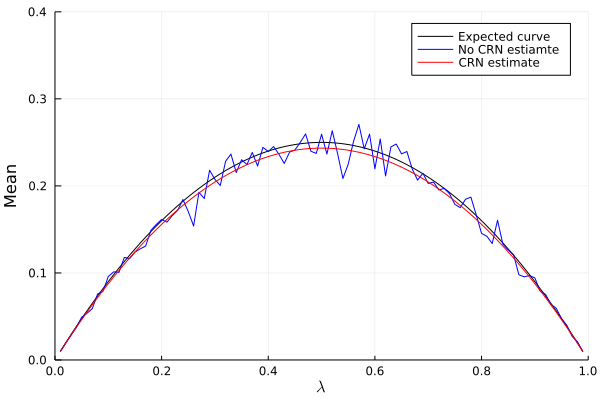

In [75]:
seed = 1
N = 100
λ_grid = 0.01:0.01:0.99

theorM(λ) = mean(Uniform(0,2λ*(1-λ)))
estM(λ) = mean(rand(Uniform(0,2λ*(1-λ)),N))

function estM(λ, seed)
    Random.seed!(seed)
    estM(λ)
end

trueM = theorM.(λ_grid)
estM0 = estM.(λ_grid)
estMCRN = estM.(λ_grid,seed)

plot(λ_grid, trueM, c=:black, label="Expected curve")
plot!(λ_grid, estM0, c=:blue, label="No CRN estiamte")
plot!(λ_grid, estMCRN, c=:red, label="CRN estimate", 
    xlims=(0,1), ylims=(0,0.4), xlabel=L"\lambda", ylabel = "Mean")

#### Multiple RNGs

Say we want to estimate the mean of 
$$
X=\sum_{i=1}^{N} Z_{i}
$$
with $N \sim \operatorname{Poisson}(K \lambda)$ and $Z_{i} \sim \text { Uniform }(0,2(1-\lambda))$  with  $\lambda \in(0,1)$  and $K>0$.

$$
\mathbb{E}_{\lambda}[X]=K \lambda(1-\lambda)
$$

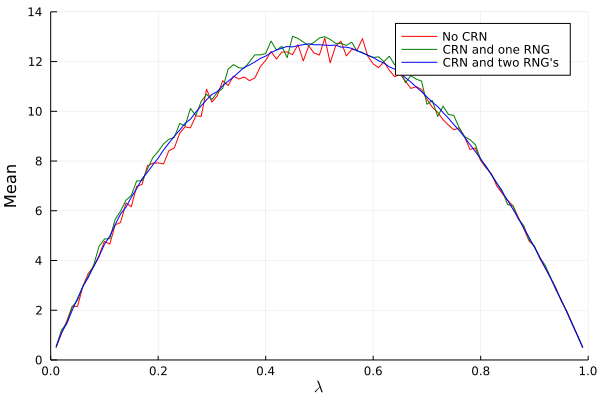

In [76]:
K = 50

prn(λ,rng) = quantile(Poisson(λ),rand(rng))
zDist(λ) = Uniform(0,2*(1-λ))

rv(λ,rng) = sum([rand(rng,zDist(λ)) for _ in 1:prn(K*λ, rng)])
rv2(λ,rng1,rng2) = sum([rand(rng1,zDist(λ)) for _ in 1:prn(K*λ,rng2)])

mEst(λ,rng) = mean([rv(λ,rng) for _ in 1:N])
mEst2(λ,rng1,rng2) = mean([rv2(λ,rng1,rng2) for _ in 1:N])

#No Common Random Numbers (CRN)
function mGraph0(seed)
    singleRng = MersenneTwister(seed)
    [mEst(λ,singleRng) for λ in λ_grid]
end

#CRN but single random number generator (RNG)
mGraph1(seed) = [mEst(λ,MersenneTwister(seed)) for λ in λ_grid]

#CRN with two random number generators
mGraph2(seed1,seed2) = [mEst2(λ,MersenneTwister(seed1), MersenneTwister(seed2)) for λ in λ_grid]

plot(λ_grid,mGraph0(1987), c=:red, label="No CRN")
plot!(λ_grid,mGraph1(1987), c=:green, label="CRN and one RNG")
plot!(λ_grid,mGraph2(1987,1988), c=:blue, label="CRN and two RNG's", xlims=(0,1),ylims=(0,14),
    xlabel=L"\lambda", ylabel = "Mean")

In [77]:
argMaxλ(graph) = λ_grid[findmax(graph)[2]]

M = 10^3
std0 = std([argMaxλ(mGraph0(seed)) for seed in 1:M])
std1 = std([argMaxλ(mGraph1(seed)) for seed in 1:M])
std2 = std([argMaxλ(mGraph2(seed,seed+M)) for seed in 1:M])

println("Standard deviation with no CRN: ", std0)
println("Standard deviation with CRN and single RNG: ", std1)
println("Standard deviation with CRN and two RNGs: ", std2)

Standard deviation with no CRN: 0.03708052002015299
Standard deviation with CRN and single RNG: 0.03411444555309959
Standard deviation with CRN and two RNGs: 0.014645353747396703


<a id='just-rcall'></a>
# Do you still miss R? So Just `RCall`.
[home](#home)

See the docs for [RCall.jl](https://juliainterop.github.io/RCall.jl/stable/)

In [78]:
using RCall

data1 = DataFrame(CSV.File("./data/machine1.csv", header=false))[:,1]
data2 = DataFrame(CSV.File("./data/machine2.csv", header=false))[:,1]
data3 = DataFrame(CSV.File("./data/machine3.csv", header=false))[:,1]

function R_ANOVA(allData)
    data = vcat([ [x fill(i, length(x))] for (i, x) in enumerate(allData) ]...)
    df = DataFrame(data, [:Diameter, :MachNo])
    @rput df

    R"""
    df$MachNo <- as.factor(df$MachNo)
    anova <- summary(aov( Diameter ~ MachNo, data=df))
    fVal <- anova[[1]]["F value"][[1]][1]
    pVal <- anova[[1]]["Pr(>F)"][[1]][1]
    """
    println("R ANOVA f-value: ", @rget fVal)
    println("R ANOVA p-value: ", @rget pVal)
end

R_ANOVA([data1, data2, data3])

R ANOVA f-value: 10.516968568709089
R ANOVA p-value: 0.00014236168817139574


To use Julia from R, use [JuliaCall](https://cran.r-project.org/web/packages/JuliaCall/index.html)

<a id='some-plots'></a>
# Some `Plots`.
[home](#home)

See example [image gallery](https://statisticswithjulia.org/gallery.html) with code - part of "Statistics with Julia" book.

See docs for [Plots.jl](http://docs.juliaplots.org/latest//) and [StatsPlots.jl](https://github.com/JuliaPlots/StatsPlots.jl)

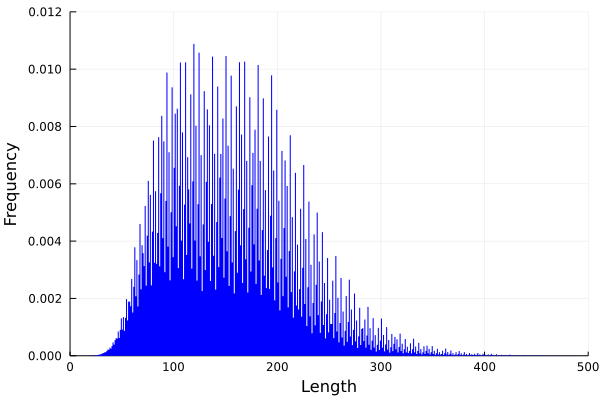

In [79]:
function hailLength(x::Int)
    n = 0
    while x != 1
        if x % 2 == 0
            x = x ÷ 2 #\div + [TAB]
        else
            x = 3x +1
        end
        n += 1
    end
    return n
end

lengths = [hailLength(x₀) for x₀ in 2:10^7] #\_0 + [TAB]

histogram(lengths, bins=1000, normed=:true, 
    fill=(:blue, true), la=0, legend=:none,
    xlims=(0, 500), ylims=(0, 0.012),
    xlabel="Length", ylabel="Frequency")

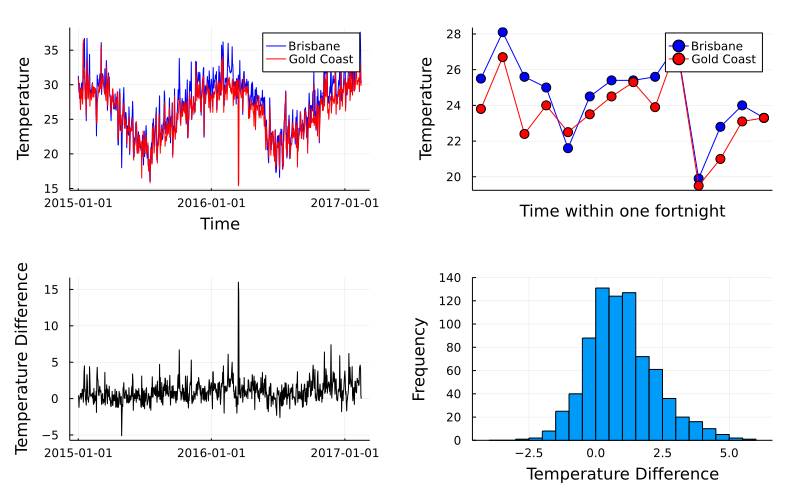

In [80]:
data = CSV.File("./data/temperatures.csv") |> DataFrame
brisbane = data.Brisbane
goldcoast = data.GoldCoast

diff = brisbane - goldcoast
dates = [Date(
            Year(data.Year[i]), 
            Month(data.Month[i]), 
            Day(data.Day[i])
        ) for i in 1:nrow(data)]

fortnightRange = 250:263
brisFortnight = brisbane[fortnightRange]
goldFortnight = goldcoast[fortnightRange]

p1 = plot(dates, [brisbane goldcoast], 
        c=[:blue :red], xlabel="Time", ylabel="Temperature", label=["Brisbane" "Gold Coast"])
p2 = plot(dates[fortnightRange], [brisFortnight goldFortnight], xticks=:none,
        c=[:blue :red], m=(:dot, 5, Plots.stroke(1)), ylabel="Temperature",
        label=["Brisbane" "Gold Coast"], xlabel="Time within one fortnight")
p3 = plot(dates, diff, 
        c=:black, ylabel="Temperature Difference",legend=false)
p4 = histogram(diff, bins=-4:0.5:6, 
        ylims=(0,140), legend = false,
        xlabel="Temperature Difference", ylabel="Frequency")
plot(p1,p2,p3,p4, size = (800,500), margin = 5mm)

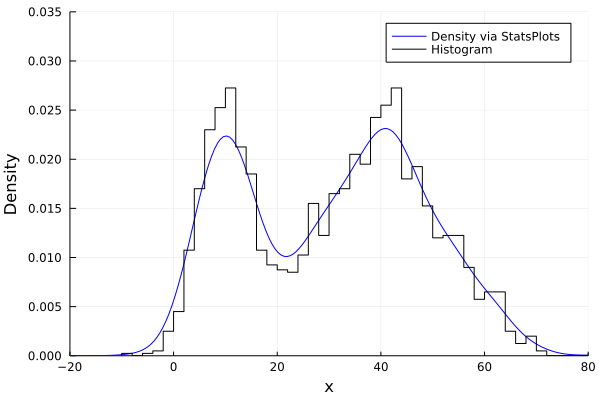

In [81]:
fix_seed!()

μ₁, σ₁ = 10, 5 #\mu + [TAB] \_1 + [TAB] etc...
μ₂, σ₂ = 40, 12
dist1, dist2 = Normal(μ₁,σ₁), Normal(μ₂,σ₂)
p = 0.3
mixRv() = (rand() <= p) ? rand(dist1) : rand(dist2)

n = 2000
data = [mixRv() for _ in 1:n]

density(data, c=:blue, label="Density via StatsPlots", xlims=(-20,80), ylims=(0,0.035))
stephist!(data, bins=50, c=:black, norm=true, label="Histogram", xlabel="x", ylabel = "Density")

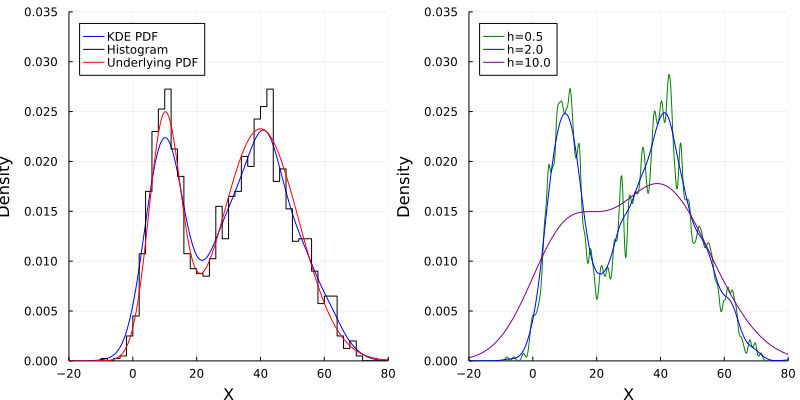

In [82]:
mixPDF(x) = p*pdf(dist1,x) + (1-p)*pdf(dist2,x)

kdeDist = kde(data)

xGrid = -20:0.1:80
pdfKDE = pdf(kdeDist,xGrid)

p1 = plot(xGrid, pdfKDE, c=:blue, label="KDE PDF")
stephist!(data, bins=50, c=:black, normed=:true, label="Histogram")
plot!(xGrid, mixPDF.(xGrid), c=:red, label="Underlying PDF",
    xlims=(-20,80), ylims=(0,0.035), legend=:topleft,
    xlabel="X", ylabel = "Density")

hVals = [0.5,2,10]
kdeS = [kde(data,bandwidth=h) for h in hVals]

p2 = plot(xGrid, pdf(kdeS[1],xGrid), c = :green, label= "h=$(hVals[1])")
plot!(xGrid, pdf(kdeS[2],xGrid), c = :blue, label= "h=$(hVals[2])")
plot!(xGrid, pdf(kdeS[3],xGrid), c = :purple, label= "h=$(hVals[3])",
    xlims=(-20,80), ylims=(0,0.035), legend=:topleft, 
    xlabel="X", ylabel = "Density")

plot(p1,p2,size = (800,400))

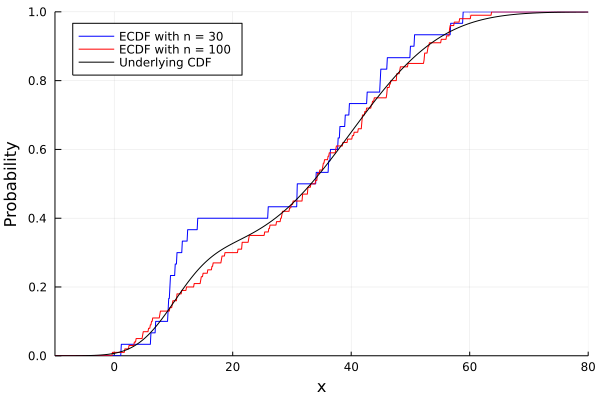

In [87]:
fix_seed!()

mixCDF(x) = p*cdf(dist1,x) + (1-p)*cdf(dist2,x)

n = [30, 100]
data1 = [mixRv() for _ in 1:n[1]]
data2 = [mixRv() for _ in 1:n[2]]

empiricalCDF1 = ecdf(data1)
empiricalCDF2 = ecdf(data2)

xGrid = -10:0.1:80
plot(xGrid,empiricalCDF1.(xGrid), c=:blue, label="ECDF with n = $(n[1])")
plot!(xGrid,empiricalCDF2.(xGrid), c=:red, label="ECDF with n = $(n[2])")
plot!(xGrid, mixCDF.(xGrid), c=:black, label="Underlying CDF",
    xlims=(-10,80), ylims=(0,1), 
    xlabel="x", ylabel="Probability", legend=:topleft)

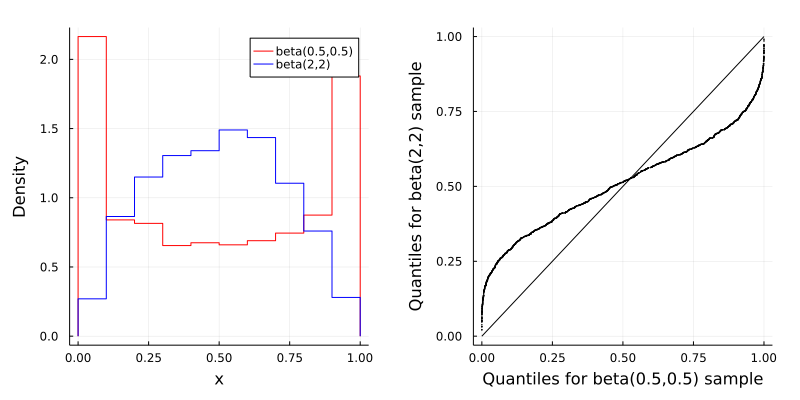

In [83]:
fix_seed!()

b1, b2 = 0.5 , 2
dist1, dist2, = Beta(b1,b1), Beta(b2,b2)
 
n = 2000
data1 = rand(dist1,n)
data2 = rand(dist2,n)

stephist(data1, bins=15, label = "beta($b1,$b1)", c = :red, normed = true)
p1 = stephist!(data2, bins=15, label = "beta($b2,$b2)",
        c = :blue, xlabel="x", ylabel="Density",normed = true)

p2 = qqplot(data1, data2, c=:black, ms=1, msw =0,
        xlabel="Quantiles for beta($b1,$b1) sample",
        ylabel="Quantiles for beta($b2,$b2) sample",
        legend=false)

plot(p1, p2, size=(800,400), margin = 5mm)

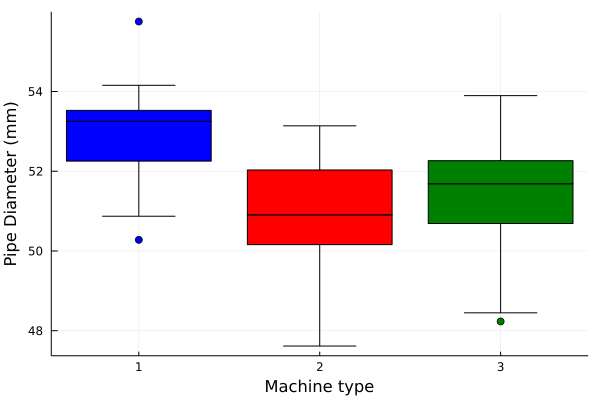

In [84]:
data1 = parse.(Float64, readlines("./data/machine1.csv"))
data2 = parse.(Float64, readlines("./data/machine2.csv"))
data3 = parse.(Float64, readlines("./data/machine3.csv"))

boxplot([data1,data2,data3], c=[:blue :red :green], label="", 
    xticks=([1:1:3;], ["1", "2", "3"]), xlabel="Machine type",
    ylabel="Pipe Diameter (mm)")

<a id='favorite-distribution'></a>
# Your favorite `Distribution`.
[home](#home)

See [Docs for `Distributions.jl`](https://juliastats.org/Distributions.jl/latest/)

In [85]:
dist = Normal(2.5,1.2)

Normal{Float64}(μ=2.5, σ=1.2)

In [86]:
mean(dist), var(dist)

(2.5, 1.44)

In [87]:
fix_seed!()
rand(dist,3,2,5) #a 3-tensor

3×2×5 Array{Float64, 3}:
[:, :, 1] =
 3.31493  2.33818
 3.4941   3.20394
 2.07639  2.8568

[:, :, 2] =
 2.57794  4.3892
 2.36918  1.67331
 1.88295  1.58464

[:, :, 3] =
 2.97698   2.27491
 3.47396   0.571292
 2.08437  -0.476951

[:, :, 4] =
 5.23148  1.7785
 2.76363  3.87073
 2.35943  2.39366

[:, :, 5] =
 2.83536  3.06846
 2.63371  2.86028
 2.07054  1.58479

In [88]:
? NegativeBinomial

search: NegativeBinomial NegativeBinomialLink



```
NegativeBinomial(r,p)
```

A *Negative binomial distribution* describes the number of failures before the `r`th success in a sequence of independent Bernoulli trials. It is parameterized by `r`, the number of successes, and `p`, the probability of success in an individual trial.

$$
P(X = k) = {k + r - 1 \choose k} p^r (1 - p)^k, \quad \text{for } k = 0,1,2,\ldots.
$$

The distribution remains well-defined for any positive `r`, in which case

$$
P(X = k) = \frac{\Gamma(k+r)}{k! \Gamma(r)} p^r (1 - p)^k, \quad \text{for } k = 0,1,2,\ldots.
$$

```julia
NegativeBinomial()        # Negative binomial distribution with r = 1 and p = 0.5
NegativeBinomial(r, p)    # Negative binomial distribution with r successes and success rate p

params(d)       # Get the parameters, i.e. (r, p)
succprob(d)     # Get the success rate, i.e. p
failprob(d)     # Get the failure rate, i.e. 1 - p
```

External links:

  * [Negative binomial distribution on Wolfram](https://reference.wolfram.com/language/ref/NegativeBinomialDistribution.html)

Note: The definition of the negative binomial distribution in Wolfram is different from the [Wikipedia definition](http://en.wikipedia.org/wiki/Negative_binomial_distribution). In Wikipedia, `r` is the number of failures and `k` is the number of successes.


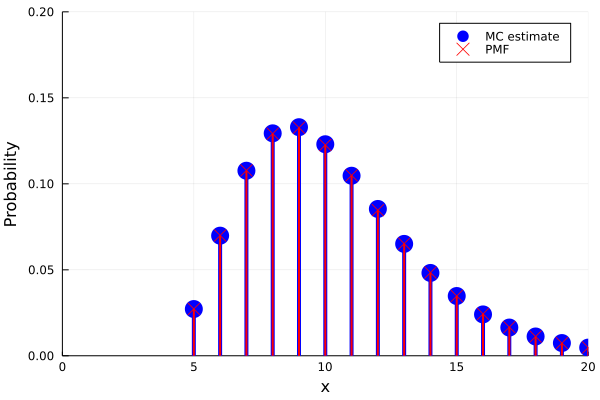

In [89]:
fix_seed!()

function rouletteSpins(r,p)
    x = 0
    wins = 0
    while true
        x += 1
        if rand() < p
            wins += 1
            if wins == r
                return x
            end
        end
    end
end

r, p, N = 5, 18/37,10^6
xGrid = r:r+15

mcEstimate = counts([rouletteSpins(r,p) for _ in 1:N],xGrid)/N

nbDist = NegativeBinomial(r,p)
nbPmf = [pdf(nbDist,x-r) for x in xGrid]

plot( xGrid, mcEstimate, 
    line=:stem, marker=:circle, c=:blue, 
    ms=10, msw=0, lw=4, label="MC estimate")
plot!( xGrid, nbPmf, line=:stem, 
    marker=:xcross, c=:red, ms=6, msw=0, lw=2, label="PMF", 
    xlims=(0,maximum(xGrid)), ylims=(0,0.2), 
    xlabel="x", ylabel="Probability")

In [ ]:
function plot_it(N)
    fix_seed!()
    mcEstimate = counts([rouletteSpins(r,p) for _ in 1:N],xGrid)/N

    nbDist = NegativeBinomial(r,p)
    nbPmf = [pdf(nbDist,x-r) for x in xGrid]

    plot( xGrid, mcEstimate, 
        line=:stem, marker=:circle, c=:blue, 
        ms=10, msw=0, lw=4, label="MC estimate")
    plot!( xGrid, nbPmf, line=:stem, 
        marker=:xcross, c=:red, ms=6, msw=0, lw=2, label="PMF", 
        xlims=(0,maximum(xGrid)), ylims=(0,0.2), 
        xlabel="x", ylabel="Probability",
        title="N = $N")
end

anim = Animation()

for N in union(10:10:100,200:100,1000,2000:1000:10^4)
    plot_it(N)
    frame(anim)
end

gif(anim,"sample_animation.gif",fps = 3)

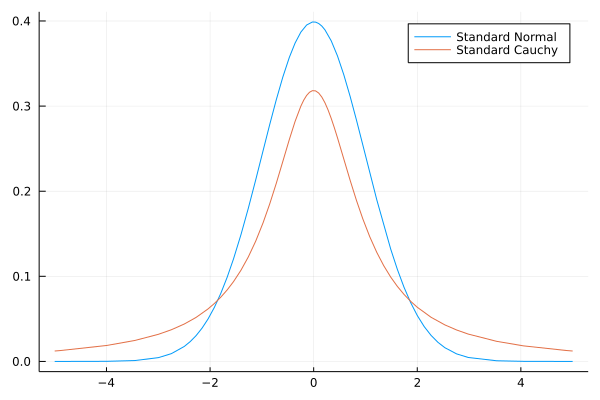

In [90]:
plot((x)->pdf(Normal(),x),label = "Standard Normal")
plot!((x)->pdf(Cauchy(),x),label = "Standard Cauchy")

In [91]:
fix_seed!()

n = 10^6
data = rand(Normal(), n)
#data = rand(Cauchy(),n) #Try this instead
averages = accumulate(+,data) ./ (1:n)

plot( 1:n, averages, 
    c=:blue, legend=:none, xscale=:log10, xlims=(1,n), xlabel="n", ylabel="Running average")

In [ ]:
fix_seed!()

N = 10^4

Σ = [ 6 4 ;
         4 9]
μ = [15 ; 
       20]
A = cholesky(Σ).L

rngGens = [()->rand(Normal()), 
           ()->rand(Uniform(-sqrt(3),sqrt(3))),
           ()->rand(Exponential())-1]

rv(rg) = A*[rg(),rg()] + μ
    
data = [[rv(r) for _ in 1:N] for r in rngGens]

stats(data) = begin
    data1, data2 = first.(data),last.(data)
    println(round(mean(data1),digits=2), "\t",round(mean(data2),digits=2),"\t",
            round(var(data1),digits=2), "\t", round(var(data2),digits=2), "\t",
            round(cov(data1,data2),digits=2))
end

println("Mean1\tMean2\tVar1\tVar2\tCov")
for d in data
    stats(d)
end

scatter(first.(data[1]), last.(data[1]), c=:blue, ms=1, msw=0, label="Normal")
scatter!(first.(data[2]), last.(data[2]), c=:red, ms=1, msw=0, label="Uniform")
scatter!(first.(data[3]), last.(data[3]), c=:green, ms=1, msw=0,label="Exponential",
    xlims=(0,40), ylims=(0,40), legend=:bottomright, ratio=:equal,
    xlabel=L"X_1", ylabel=L"X_2")

In [92]:
dist = MvNormal([1,1],[2 2.3; 2.3 4])

FullNormal(
dim: 2
μ: [1.0, 1.0]
Σ: [2.0 2.3; 2.3 4.0]
)


In [93]:
cor(dist)

2×2 Matrix{Float64}:
 1.0       0.813173
 0.813173  1.0

In [94]:
rand(dist,20)

2×20 Matrix{Float64}:
 1.77708  2.47856   0.814786  0.524519  …  0.43359  0.161094  1.72821
 3.3789   1.9274   -0.954776  0.326679     1.03035  1.11317   0.411757

See also [TruncatedDistributions.jl](https://github.com/yoninazarathy/TruncatedDistributions.jl) - still in progress as of July 2021.

<a id='love-dataframes'></a>
# We love `DataFrames`.
[home](#home)

See also:

* Yesterday's (recorded) [Dataframes tutorial](https://github.com/bkamins/JuliaCon2021-DataFrames-Tutorial) or [here](https://pretalx.com/juliacon2021/talk/FXZXMB/) by Bogumił Kamiński.
* Docs for [DataFrames.jl](https://dataframes.juliadata.org/stable/).

In [95]:
ENV["LINES"] = 10
data = CSV.File("./data/purchaseData.csv") |> DataFrame

,Name,Date,Grade,Price
,String?,String?,String?,Int64?
1,MARYANNA,14/09/2008,A,79700
2,REBECCA,11/03/2008,B,missing
3,ASHELY,5/08/2008,E,24311
4,KHADIJAH,2/09/2008,missing,38904
5,TANJA,1/12/2008,C,47052
6,JUDIE,17/05/2008,D,34365
7,NOE,15/08/2008,A,79344
8,JACALYN,7/10/2008,E,21474
9,SANDY,5/04/2008,D,missing


In [96]:
size(data)

(200, 4)

In [97]:
names(data)

4-element Vector{String}:
 "Name"
 "Date"
 "Grade"
 "Price"

In [98]:
first(data, 6)

,Name,Date,Grade,Price
,String?,String?,String?,Int64?
1,MARYANNA,14/09/2008,A,79700
2,REBECCA,11/03/2008,B,missing
3,ASHELY,5/08/2008,E,24311
4,KHADIJAH,2/09/2008,missing,38904
5,TANJA,1/12/2008,C,47052
6,JUDIE,17/05/2008,D,34365


In [99]:
describe(data)

,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,Union
1,Name,,ABBEY,,ZACHARY,17,"Union{Missing, String}"
2,Date,,1/07/2008,,9/10/2008,4,"Union{Missing, String}"
3,Grade,,A,,E,13,"Union{Missing, String}"
4,Price,39702.0,8257,38045.5,79893,14,"Union{Missing, Int64}"


In [100]:
println("Grade of person 1: ", data[1, 3], 
        ", ", data[1,:Grade], 
        ", ", data.Grade[1])

Grade of person 1: A, A, A


In [101]:
data[[1,2,4], :]

,Name,Date,Grade,Price
,String?,String?,String?,Int64?
1,MARYANNA,14/09/2008,A,79700
2,REBECCA,11/03/2008,B,missing
3,KHADIJAH,2/09/2008,missing,38904


In [102]:
data[13:15, :Name]

3-element Vector{Union{Missing, String}}:
 "SAMMIE"
 missing
 "STACEY"

In [103]:
data.Name[13:15]

3-element Vector{Union{Missing, String}}:
 "SAMMIE"
 missing
 "STACEY"

In [104]:
data[13:15, [:Name]]

,Name
,String?
1,SAMMIE
2,missing
3,STACEY


#### Mising values

In [105]:
mean(data.Price)

missing

In [106]:
ismissing.(data.Price) |> sum

14

In [107]:
mean(skipmissing(data.Price))

39702.01075268817

In [108]:
data.Grade[1:4]

4-element PooledArrays.PooledVector{Union{Missing, String}, UInt32, Vector{UInt32}}:
 "A"
 "B"
 "E"
 missing

In [109]:
coalesce.(data.Grade, "QQ")[1:4]

4-element Vector{String}:
 "A"
 "B"
 "E"
 "QQ"

In [110]:
dropmissing(data,:Price)

,Name,Date,Grade,Price
,String?,String?,String?,Int64
1,MARYANNA,14/09/2008,A,79700
2,ASHELY,5/08/2008,E,24311
3,KHADIJAH,2/09/2008,missing,38904
4,TANJA,1/12/2008,C,47052
5,JUDIE,17/05/2008,D,34365
6,NOE,15/08/2008,A,79344
7,JACALYN,7/10/2008,E,21474
8,ALEJANDRA,16/12/2008,E,20916
9,GARY,8/05/2008,C,40081


In [111]:
completecases(data) |> sum

153

In [112]:
full_obs = completecases(data) |> findall

153-element Vector{Int64}:
   1
   3
   5
   ⋮
 199
 200

In [113]:
data[setdiff(1:size(data,1), full_obs),:]

,Name,Date,Grade,Price
,String?,String?,String?,Int64?
1,REBECCA,11/03/2008,B,missing
2,KHADIJAH,2/09/2008,missing,38904
3,SANDY,5/04/2008,D,missing
4,ROSELEE,29/06/2008,missing,37661
5,missing,12/12/2008,E,17328
6,RASHIDA,missing,C,44597
7,MINERVA,31/07/2008,missing,45751
8,JARRETT,30/11/2008,missing,41182
9,missing,1/10/2008,E,20229


<a id='inference'></a>
# Gotta have some basic inference.
[home](#home)

#### Point estimation

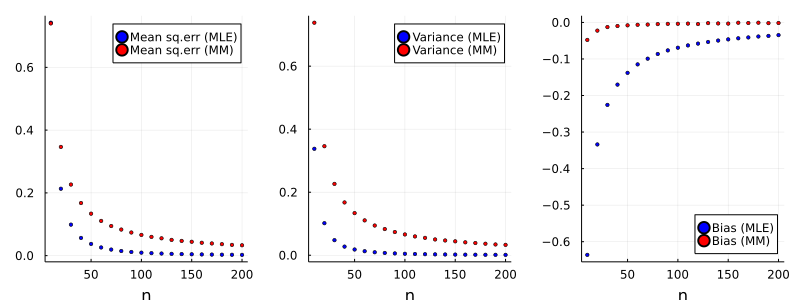

In [114]:
fix_seed!()

N = 10^5
nMin, nStep, nMax = 10, 10, 200
nn = Int(nMax/nStep)
sampleSizes = nMin:nStep:nMax
trueB = 5
trueDist = Uniform(-2, trueB)

#MLE for the upper bound
MLEest(data) = maximum(data)

#Method of moments estimator for the upper bound
MMest(data)  = mean(data) + sqrt(3)*std(data)

res = Dict{Symbol,Array{Float64}}( ((sym) -> sym => Array{Float64}(undef,nn)).(
                                [:MSeMLE,:MSeMM, :VarMLE,:VarMM,:BiasMLE,:BiasMM]))

for (i, n) in enumerate(sampleSizes)
    mleEst, mmEst = Array{Float64}(undef, N), Array{Float64}(undef, N) 
    for j in 1:N
        sample    = rand(trueDist,n)
        mleEst[j] = MLEest(sample)
        mmEst[j]  = MMest(sample)
    end
    meanMLE, meanMM = mean(mleEst), mean(mmEst)
    varMLE, varMM = var(mleEst), var(mmEst)

    res[:MSeMLE][i] = varMLE + (meanMLE - trueB)^2
    res[:MSeMM][i] = varMM + (meanMM - trueB)^2
    res[:VarMLE][i] = varMLE
    res[:VarMM][i] = varMM
    res[:BiasMLE][i] = meanMLE - trueB
    res[:BiasMM][i] = meanMM - trueB
end

p1 = scatter(sampleSizes, [res[:MSeMLE] res[:MSeMM]], c=[:blue :red],
    label=["Mean sq.err (MLE)" "Mean sq.err (MM)"])
p2 = scatter(sampleSizes, [res[:VarMLE] res[:VarMM]], c=[:blue :red],
    label=["Variance (MLE)" "Variance (MM)"])
p3 = scatter(sampleSizes, [res[:BiasMLE] res[:BiasMM]], c=[:blue :red],
    label=["Bias (MLE)" "Bias (MM)"],legend = :bottomright)

plot(p1, p2, p3, ms=2, shape=:circle, xlabel="n", 
    layout=(1,3), size=(800, 300), margin = 2mm)

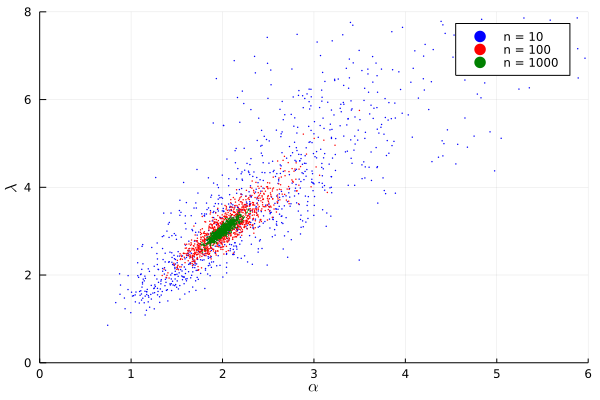

In [116]:
fix_seed!()

eq(alpha, xb, xbl) = log(alpha) - digamma(alpha) - log(xb) + xbl

actualAlpha, actualLambda = 2, 3
gammaDist = Gamma(actualAlpha,1/actualLambda)

function mle(sample)
    alpha  = find_zero( (a)->eq(a,mean(sample),mean(log.(sample))), 1)
    lambda = alpha/mean(sample)
    return [alpha,lambda]
end

N = 10^3

mles10   = [mle(rand(gammaDist,10)) for _ in 1:N]
mles100  = [mle(rand(gammaDist,100)) for _ in 1:N]
mles1000 = [mle(rand(gammaDist,1000)) for _ in 1:N]

scatter(first.(mles10), last.(mles10), 
    c=:blue, ms=1, msw=0, label="n = 10")
scatter!(first.(mles100), last.(mles100), 
    c=:red, ms=1, msw=0, label="n = 100")
scatter!(first.(mles1000), last.(mles1000), 
    c=:green, ms=1, msw=0, label="n = 1000", 
    xlims=(0,6), ylims=(0,8), xlabel=L"\alpha", ylabel=L"\lambda")

#### Confidence Intervals

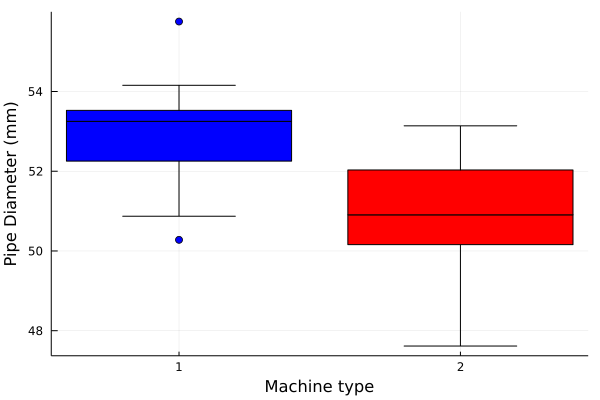

In [117]:
data1 = (CSV.File("./data/machine1.csv", header=false) |> DataFrame)[:,1]
data2 = (CSV.File("./data/machine2.csv", header=false) |> DataFrame)[:,1]
boxplot([data1,data2], c=[:blue :red], label="", 
    xticks=([1:2;], ["1", "2"]), xlabel="Machine type",
    ylabel="Pipe Diameter (mm)")

In [118]:
α = 0.05 #\alpha + [TAB]
confint(EqualVarianceTTest(data1,data2),α)

(1.1127539574575822, 2.90486485574026)

In [119]:
#Doing it manually
xBar1, xBar2 = mean(data1), mean(data2)
n1, n2 = length(data1), length(data2)
t = quantile(TDist(n1+n2-2),1-α/2)

s1, s2 = std(data1), std(data2)
sP = sqrt(((n1-1)*s1^2 + (n2-1)*s2^2) / (n1+n2-2))

(xBar1 - xBar2 - t*sP* sqrt(1/n1 + 1/n2), xBar1 - xBar2 + t*sP* sqrt(1/n1 + 1/n2))

(1.1127539574575822, 2.90486485574026)

#### Hypothesis Tests

In [120]:
δ₀ = 0
test_result =UnequalVarianceTTest(data1, data2, δ₀)

Two sample t-test (unequal variance)
------------------------------------
Population details:
    parameter of interest:   Mean difference
    value under h_0:         0
    point estimate:          2.00881
    95% confidence interval: (1.096, 2.9216)

Test summary:
    outcome with 95% confidence: reject h_0
    two-sided p-value:           <1e-04

Details:
    number of observations:   [20,18]
    t-statistic:              4.483705005611673
    degrees of freedom:       31.82453144280282
    empirical standard error: 0.4480244360600785


In [121]:
test_result.df

31.82453144280282

In [122]:
pvalue(test_result)

8.936189820682969e-5

In [ ]:
methods(pvalue)

In [123]:
@which pvalue(test_result)

pvalue(x::HypothesisTests.TTest; tail) in HypothesisTests at /Users/uqjnazar/.julia/packages/HypothesisTests/V7PST/src/t.jl:31

In [124]:
xBar1, s1, n1 = mean(data1), std(data1), length(data1)
xBar2, s2, n2 = mean(data2), std(data2), length(data2)

v = ( s1^2/n1 + s2^2/n2 )^2 / ( (s1^2/n1)^2/(n1-1) + (s2^2/n2)^2/(n2-1)  )
testStatistic = ( xBar1-xBar2 - δ₀ )  / sqrt( s1^2/n1 + s2^2/n2 )
pVal = 2*ccdf(TDist(v), abs(testStatistic))

println("Manually calculated degrees of freedom, v: ", v)
println("Manually calculated test statistic: ", testStatistic)
println("Manually calculated p-value: ", pVal, "\n")

Manually calculated degrees of freedom, v: 31.82453144280283
Manually calculated test statistic: 4.483705005611673
Manually calculated p-value: 8.936189820683007e-5



In [125]:
data = CSV.File("./data/fertilizer.csv") |> DataFrame

control = data.Control
fertilizer = data.FertilizerX

subGroups = collect(combinations([control;fertilizer],10))

meanFert = mean(fertilizer)
pVal = sum([mean(i) >= meanFert for i in subGroups])/length(subGroups)
println("p-value = ", pVal)

p-value = 0.023972157873086666


<a id='linear-models'></a>
# Linear models at our core.
[home](#home)

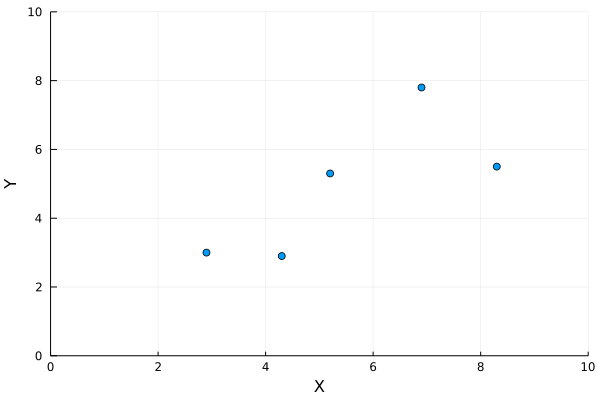

In [126]:
data = CSV.File("./data/L1L2data.csv") |> DataFrame
xVals, yVals = data[:,1], data[:,2]
scatter(xVals,yVals,label=false,xlim=(0,10),ylim=(0,10),xlabel="X", ylabel="Y")

In [127]:
n = length(xVals)
A = [ones(n) xVals] #The "design matrix"

5×2 Matrix{Float64}:
 1.0  2.9
 1.0  4.3
 1.0  5.2
 1.0  6.9
 1.0  8.3

In [128]:
# Approach A
xBar, yBar = mean(xVals),mean(yVals)
sXX, sXY = ones(n)'*(xVals.-xBar).^2 , dot(xVals.-xBar,yVals.-yBar)
b1A = sXY/sXX
b0A = yBar - b1A*xBar

# Approach B
b1B = cor(xVals,yVals)*(std(yVals)/std(xVals))
b0B = yBar - b1B*xBar

# Approach C
b0C, b1C = A'A \ A'yVals

# Approach D
Adag = inv(A'*A)*A'
b0D, b1D = Adag*yVals

# Approach E
b0E, b1E = pinv(A)*yVals

# Approach F
b0F, b1F = A\yVals

# Approach G
F = qr(A)
Q, R = F.Q, F.R
b0G, b1G = (inv(R)*Q')*yVals

# Approach H
F = svd(A)
V, Sp, Us = F.V, Diagonal(1 ./ F.S), F.U'
b0H, b1H = (V*Sp*Us)*yVals

# Approach I
eta, eps = 0.002, 10^-6.
b, bPrev = [0,0], [1,1]
while norm(bPrev-b) >= eps
    global bPrev = b
    global b = b - eta*2*A'*(A*b - yVals)
end
b0I, b1I = b[1], b[2]

# Approach J
modelJ = lm(@formula(Y ~ X), data)
b0J, b1J = coef(modelJ)

# Approach K
modelK = glm(@formula(Y ~ X), data, Normal())
b0K, b1K = coef(modelK)

println(round.([b0A,b0B,b0C,b0D,b0E,b0F,b0G,b0H,b0I,b0J,b0K],digits=3))
println(round.([b1A,b1B,b1C,b1D,b1E,b1F,b1G,b1H,b1I,b1J,b1K],digits=3))

[0.945, 0.945, 0.945, 0.945, 0.945, 0.945, 0.945, 0.945, 0.944, 0.945, 0.945]
[0.716, 0.716, 0.716, 0.716, 0.716, 0.716, 0.716, 0.716, 0.717, 0.716, 0.716]


***Output of LM Model:
StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}}}}, Matrix{Float64}}

Height ~ 1 + Weight

Coefficients:
────────────────────────────────────────────────────────────────────────────
                  Coef.  Std. Error      t  Pr(>|t|)   Lower 95%   Upper 95%
────────────────────────────────────────────────────────────────────────────
(Intercept)  135.793      1.95553    69.44    <1e-99  131.937     139.649
Weight         0.532299   0.0293556  18.13    <1e-43    0.474409    0.590188
────────────────────────────────────────────────────────────────────────────

***Output of GLM Model:
StatsModels.TableRegressionModel{GeneralizedLinearModel{GLM.GlmResp{Vector{Float64}, Normal{Float64}, IdentityLink}, GLM.DensePredChol{Float64, Cholesky{Float64, Matrix{Float64}}}}, Matrix{Float64}}

Height ~ 1 + Weight

Coefficients:
───────────────────────────────────────────────────────────

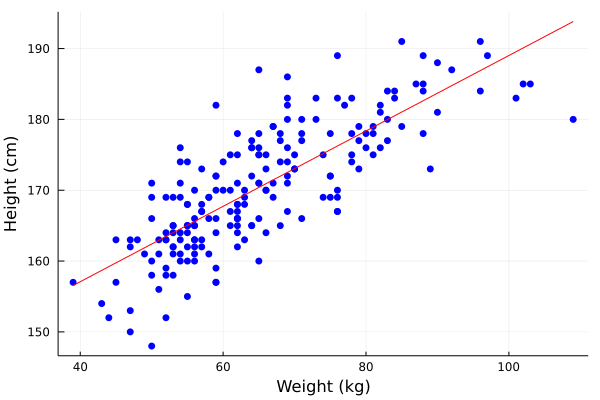

In [131]:
data = CSV.File("./data/weightHeight.csv") |> DataFrame

lm1 = lm(@formula(Height ~ Weight), data)
lm2 = fit(LinearModel,@formula(Height ~ Weight), data)

glm1 = glm(@formula(Height ~ Weight), data, Normal(), IdentityLink())
glm2 = fit(GeneralizedLinearModel,@formula(Height ~ Weight), data, Normal(), IdentityLink())

println("***Output of LM Model:")
println(lm1)
println("\n***Output of GLM Model:")
println(glm1)

pred(x) = coef(lm1)'*[1, x]

println("\n***Individual methods applied to model output:")
println("Deviance: ",deviance(lm1))
println("Standard error: ",stderror(lm1))
println("Degrees of freedom: ",dof_residual(lm1))
println("Covariance matrix: ",vcov(lm1))

yVals = data.Height
SStotal = sum((yVals .- mean(yVals)).^2)

println("R squared (calculated in two ways):",r2(lm1),
        ",\t", 1 - deviance(lm1)/SStotal)

println("MSE (calculated in two ways: ",deviance(lm1)/dof_residual(lm1),
        ",\t",sum((pred.(data.Weight) - data.Height).^2)/(size(data)[1] - 2))

xlims = [minimum(data.Weight), maximum(data.Weight)]
scatter(data.Weight, data.Height, c=:blue, msw=0)
plot!(xlims, pred.(xlims), 
    c=:red, xlims=(xlims), 
    xlabel="Weight (kg)", ylabel="Height (cm)", legend=:none)

#### Multiple variables

In [132]:
df = RDatasets.dataset("MASS", "cpus")
df.Freq = map( x->10^9/x , df.CycT)

model = lm(@formula(Perf ~ MMax + Cach + ChMax + Freq), df)
pred(x) = round(coef(model)'*vcat(1,x),digits = 3)

println("n = ", size(df)[1])
println("(Avg,Std) of observed performance: ", (mean(df.Perf),std(df.Perf)))
println(model)
println("Estimated performance for computer A: ", pred([32000, 32, 32, 4*10^7]))
println("Estimated performance for computer B: ", pred([32000, 16, 32, 6*10^7]))

n = 209
(Avg,Std) of observed performance: (105.61722488038278, 160.83058719907774)
StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}}}}, Matrix{Float64}}

Perf ~ 1 + MMax + Cach + ChMax + Freq

Coefficients:
───────────────────────────────────────────────────────────────────────────────────
                    Coef.   Std. Error      t  Pr(>|t|)     Lower 95%     Upper 95%
───────────────────────────────────────────────────────────────────────────────────
(Intercept)  -46.5763      7.62382      -6.11    <1e-08  -61.6078      -31.5447
MMax           0.00841457  0.000639214  13.16    <1e-28    0.00715426    0.00967489
Cach           0.872508    0.152825      5.71    <1e-07    0.571189      1.17383
ChMax          0.96736     0.234847      4.12    <1e-04    0.504321      1.4304
Freq           9.74951e-7  5.5502e-7     1.76    0.0805   -1.1936e-7     2.06926e-6
──────────────────────────────────────

#### Categorical variables

StatsModels.TableRegressionModel{LinearModel{GLM.LmResp{Vector{Float64}}, GLM.DensePredChol{Float64, CholeskyPivoted{Float64, Matrix{Float64}}}}, Matrix{Float64}}

Height ~ 1 + Weight + Sex

Coefficients:
────────────────────────────────────────────────────────────────────────────
                  Coef.  Std. Error      t  Pr(>|t|)   Lower 95%   Upper 95%
────────────────────────────────────────────────────────────────────────────
(Intercept)  142.222      2.25513    63.07    <1e-99  137.774     146.669
Weight         0.395472   0.0385469  10.26    <1e-19    0.319449    0.471494
Sex: M         5.43604    1.06158     5.12    <1e-06    3.34238     7.52969
Sex: O1        4.9942     1.89707     2.63    0.0092    1.25279     8.7356
Sex: O2        3.34589    1.89924     1.76    0.0797   -0.399795    7.09158
────────────────────────────────────────────────────────────────────────────


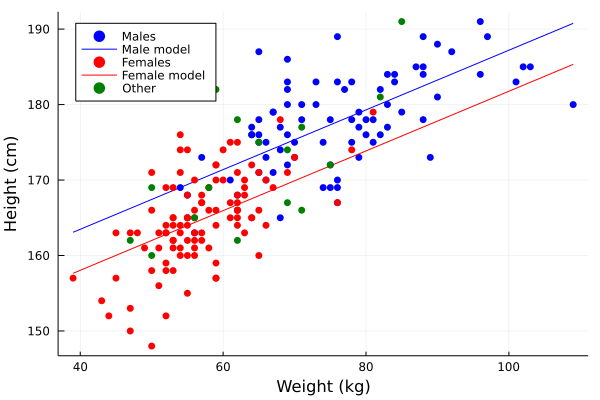

In [133]:
df = CSV.File("./data/weightHeight.csv") |> DataFrame
n = size(df)[1]
df[shuffle(1:n),:] = df
df[[10,40,60,130,140,175,190,200],:Sex] .= "O1"
df[[9,44,63,132,138,172,192,199],:Sex] .= "O2"

model = lm(@formula(Height ~ Weight + Sex), df,
        contrasts=Dict(:Sex=>DummyCoding(base="F",levels=["M","O1","O2","F"])))
b0, b1, b2, b3, b4  = coef(model)
pred(weight,sex) = b0+b1*weight+b2*(sex=="M")+b3*(sex=="O1")+b3*(sex=="O2")
println(model)

males = df[df.Sex .== "M",:]
females = df[df.Sex .== "F",:]
other = df[(df.Sex .!= "M") .& (df.Sex .!= "F"),:]

xlim = [minimum(df.Weight), maximum(df.Weight)]
scatter(males.Weight, males.Height, c=:blue, msw=0, label="Males")
plot!(xlim, pred.(xlim,"M"), c=:blue, label="Male model")

scatter!(females.Weight, females.Height, c=:red, msw=0, label="Females")
plot!(xlim, pred.(xlim,"F"), 
    c=:red, label="Female model", xlims=(xlim), 
    xlabel="Weight (kg)", ylabel="Height (cm)", legend=:topleft)

scatter!(other.Weight, other.Height, c=:green, msw=0, label="Other")

#### Variable selection with LASSO

LassoPath (2) solutions for 7 predictors in 84 iterations):
───────────────────────────
        λ   pct_dev  ncoefs
───────────────────────────
[1]  54.0  0.673402       4
[2]  54.2  0.67203        3
───────────────────────────
Coefficients: [0.0, 0.005294014227461394, 0.0056046927214597085, 0.1452042414908439, 0.0, 0.0]


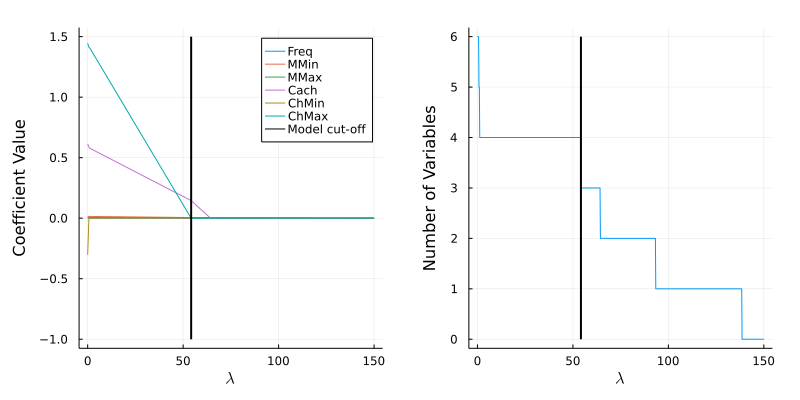

In [134]:
df = RDatasets.dataset("MASS", "cpus")
df.Freq = map( x->10^9/x , df.CycT)
df = df[:, [:Perf, :Freq, :MMin, :MMax, :Cach, :ChMin, :ChMax]]
X = [df.Freq df.MMin df.MMax df.Cach df.ChMin df.ChMax]
Y = df.Perf

targetNumVars = 3

lambdaStep = 0.2
lamGrid = collect(0:lambdaStep:150)
lassoFit = fit(LassoPath,X, Y, λ = lamGrid);
dd = Array(lassoFit.coefs)'
nV = sum(dd .!= 0.0 ,dims=2)

goodLambda = lamGrid[findfirst((n)->n==targetNumVars,nV)]
newFit = fit(LassoPath,X, Y, λ = [goodLambda - lambdaStep, goodLambda])
println(newFit)
println("Coefficients: ", Array(newFit.coefs)'[2,:])

p1 = plot(lassoFit.λ, dd, label = ["Freq" "MMin" "MMax" "Cach" "ChMin" "ChMax"],
    ylabel = "Coefficient Value")
plot!([goodLambda,goodLambda],[-1,1.5],c=:black, lw=2, label = "Model cut-off")

p2 = plot(lassoFit.λ,nV, ylabel = "Number of Variables",legend = false)
plot!([goodLambda,goodLambda],[0,6],c=:black, lw=2, label = "Model cut-off")

plot(p1,p2,xlabel= L"\lambda", margin = 5mm, size = (800,400))

#### Generalized linear models

In [135]:
df = RDatasets.dataset("MASS", "cpus")
n = size(df)[1]
df = df[shuffle(1:n),:]

pTest = 0.2
lastTindex = Int(floor(n*(1-pTest)))
numTest = n - lastTindex

train = df[1:lastTindex,:]
test = df[lastTindex+1:n,:]

form = @formula(Perf~CycT+MMin+MMax+Cach+ChMin+ChMax)
model1 = glm(form, train, Normal(),  IdentityLink())
model2 = glm(form, train, Poisson(), LogLink())
model3 = glm(form, train, Gamma(),  InverseLink())

invIdenityLink(x) = x
invLogLink(x) = exp(x)
invInverseLink(x) = 1/x

A = [ones(numTest) test.CycT test.MMin test.MMax test.Cach test.ChMin test.ChMax]
pred1 = invIdenityLink.(A*coef(model1))
pred2 = invLogLink.(A*coef(model2))
pred3 = invInverseLink.(A*coef(model3))

actual = test.Perf
lossModel1 = norm(pred1 - actual)
lossModel2 = norm(pred2 - actual)
lossModel3 = norm(pred3 - actual)

println("Model 1: ", coef(model1))
println("Model 2: ", coef(model2))
println("Model 3: ", coef(model3))
println("\nLoss of models 1,2,3: ",(lossModel1 ,lossModel2, lossModel3))

Model 1: [-50.55606205772967, 0.04285450142393169, 0.01399406794026681, 0.005031355257584691, 0.6316357447494494, -1.311328095685239, 2.1553300207222224]
Model 2: [3.8945195759189994, -0.0016767431394876507, 4.9166060035266095e-5, 2.4966622621532583e-5, 0.0041841332312894, 0.007564442680998896, 0.0032753625008630307]
Model 3: [0.009331861695600848, 6.426614460472343e-5, -1.9199651276341399e-7, -6.396010536257836e-8, -1.387921200220332e-5, -8.77583326158836e-5, -1.2008351913612887e-5]

Loss of models 1,2,3: (491.230747477762, 1891.5228513628979, 1382.2870909090702)


<a id='basic-ml'></a>
# Basic Machine learning.
[home](#home)

Some resources:

* Docs for [MLJ.jl](https://alan-turing-institute.github.io/MLJ.jl/dev/) - not used here.
* Docs for [Scikitlearn.jl](https://github.com/cstjean/ScikitLearn.jl) - not used here.
* Docs for [Flux.jl](https://fluxml.ai/Flux.jl/stable/)
* [The Mathematical Engineering of Deep Learning](https://deeplearningmath.org/amsi-summer-school-course-2021.html)
* ...

#### Applying off the shelf deep neural networks (see https://github.com/FluxML/Metalhead.jl) 

In [136]:
vgg = VGG19(); #A neural network model VGG19 (about 500Mb of parameters, from 2014)
vgg.layers

Chain(
  Conv((3, 3), 3 => 64, relu, pad=1),   # 1_792 parameters
  Conv((3, 3), 64 => 64, relu, pad=1),  # 36_928 parameters
  MaxPool((2, 2)),
  Conv((3, 3), 64 => 128, relu, pad=1),  # 73_856 parameters
  Conv((3, 3), 128 => 128, relu, pad=1),  # 147_584 parameters
  MaxPool((2, 2)),
  Conv((3, 3), 128 => 256, relu, pad=1),  # 295_168 parameters
  Conv((3, 3), 256 => 256, relu, pad=1),  # 590_080 parameters
  Conv((3, 3), 256 => 256, relu, pad=1),  # 590_080 parameters
  Conv((3, 3), 256 => 256, relu, pad=1),  # 590_080 parameters
  MaxPool((2, 2)),
  Conv((3, 3), 256 => 512, relu, pad=1),  # 1_180_160 parameters
  Conv((3, 3), 512 => 512, relu, pad=1),  # 2_359_808 parameters
  Conv((3, 3), 512 => 512, relu, pad=1),  # 2_359_808 parameters
  Conv((3, 3), 512 => 512, relu, pad=1),  # 2_359_808 parameters
  MaxPool((2, 2)),
  Conv((3, 3), 512 => 512, relu, pad=1),  # 2_359_808 parameters
  Conv((3, 3), 512 => 512, relu, pad=1),  # 2_359_808 parameters
  Conv((3, 3), 512 => 512, relu,

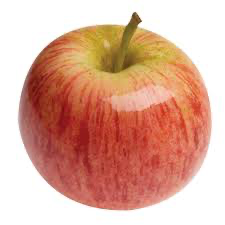

In [137]:
#download an arbitrary image and try to classify it
download("https://deeplearningmath.org/data/images/appleFruit.jpg","appleFruit.jpg");
img = load("appleFruit.jpg")

In [138]:
@time begin
    classify(vgg,img) #vgg is the model
end

 12.433114 seconds (34.86 M allocations: 2.427 GiB, 3.33% gc time)


"Granny Smith"

#### Clustering with $k$-means

Number of clusters: 3
Counts of clusters: [899, 952, 1149]


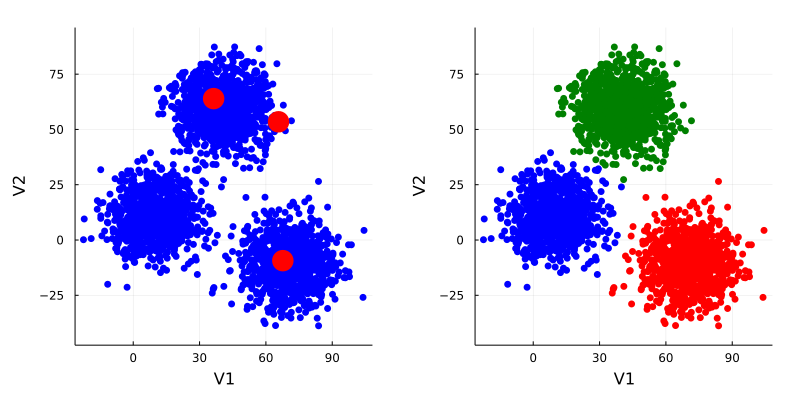

In [139]:
fix_seed!()

K = 3
df = RDatasets.dataset("cluster", "xclara")
data = Matrix(df)'

seeds = initseeds(:rand, data, K)
xclaraKmeans = kmeans(data, K, init = seeds)

println("Number of clusters: ", nclusters(xclaraKmeans))
println("Counts of clusters: ", counts(xclaraKmeans))

df.Group  = assignments(xclaraKmeans)

p1 = scatter(df[:, :V1], df[:, :V2], c=:blue, msw=0)
     scatter!(df[seeds, :V1], df[seeds, :V2], markersize=12, c=:red, msw=0)

p2 = scatter( df[df.Group .== 1, :V1], df[df.Group .== 1, :V2], c=:blue, msw=0)
     scatter!( df[df.Group .== 2, :V1], df[df.Group .== 2, :V2], c=:red, msw=0)
     scatter!( df[df.Group .== 3, :V1], df[df.Group .== 3, :V2], c=:green, msw=0)

plot(p1,p2,legend=:none,ratio=:equal, size=(800,400), xlabel="V1", ylabel="V2", margin = 5mm)

#### The MNIST digits dataset

In [140]:
using MLDatasets

In [141]:
train_data = MLDatasets.MNIST.traindata(Float64)

imgs = train_data[1]
@show typeof(imgs)
@show size(imgs)

labels = train_data[2]
@show typeof(labels);

typeof(imgs) = Array{Float64, 3}
size(imgs) = (28, 28, 60000)
typeof(labels) = Vector{Int64}


In [142]:
test_data = MLDatasets.MNIST.testdata(Float64)
test_imgs = test_data[1]
test_labels = test_data[2]
@show size(test_imgs);

size(test_imgs) = (28, 28, 10000)


In [143]:
n_train, n_test = length(labels), length(test_labels)

(60000, 10000)

,,,,

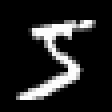
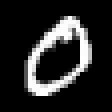
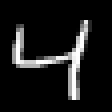
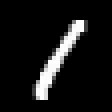
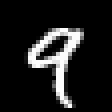

In [144]:
[Gray.(train_data[1][:,:,k]') for k in 1:5]

In [ ]:
X = vcat([vec(imgs[:,:,k])' for k in 1:last(size(imgs))]...)
@show size(X)
heatmap(X,legend=false)

#### Principal component analysis (PCA)

In [147]:
pca = fit(PCA, X'; maxoutdim=2)
M = projection(pca)

args = (ms=0.8, msw=0, xlims=(-5,12.5), ylims=(-7.5,7.5),
            legend = :topright, xlabel="PC 1", ylabel="PC 2")

function compareDigits(dA,dB)
    xA = X[labels .== dA, :]'
    xB = X[labels .== dB, :]'
    zA, zB = M'*xA, M'*xB
    
    scatter(zA[1,:], zA[2,:], c=:red, label="Digit $(dA)"; args...)
    scatter!(zB[1,:], zB[2,:], c=:blue, label="Digit $(dB)"; args...)
end

plots = []
for k in 1:5
    push!(plots,compareDigits(2k-2,2k-1))
end
plot(plots...,size = (800, 500), margin = 5mm)

#### A linear classifier

In [148]:
using Flux: onehotbatch

A = [ones(n_train) X]
Adag = pinv(A)  
tfPM(x) = x ? +1 : -1
yDat(k) = tfPM.(onehotbatch(labels,0:9)'[:,k+1])
bets = [Adag*yDat(k) for k in 0:9]

linear_classify(square_image) = findmax([([1 ; vec(square_image)])'*bets[k] for k in 1:10])[2]-1

linear_classify (generic function with 1 method)

In [149]:
predictions = [linear_classify(test_imgs[:,:,k]) for k in 1:n_test]
confusionMatrix = [sum((predictions .== i) .& (test_labels .== j)) for i in 0:9, j in 0:9]
acc = sum(diag(confusionMatrix))/n_test

println("Accuracy: ", acc, "\nConfusion Matrix:")
show(stdout, "text/plain", confusionMatrix)

Accuracy: 0.8603
Confusion Matrix:
10×10 Matrix{Int64}:
 944     0   18    4    0   23   18    5   14   15
   0  1107   54   17   22   18   10   40   46   11
   1     2  813   23    6    3    9   16   11    2
   2     2   26  880    1   72    0    6   30   17
   2     3   15    5  881   24   22   26   27   80
   7     1    0   17    5  659   17    0   40    1
  14     5   42    9   10   23  875    1   15    1
   2     1   22   21    2   14    0  884   12   77
   7    14   37   22   11   39    7    0  759    4
   1     0    5   12   44   17    0   50   20  801

#### Training neural networks

In [150]:
train_range, validate_range = 1:5000, 5001:10000
batch_size = 1000

train_imgs = imgs[:,:,train_range]
train_labels = labels[train_range]
mb_idxs = Iterators.partition(1:length(train_range), batch_size)

validate_imgs = imgs[:,:,validate_range]
validate_labels = labels[validate_range];

In [151]:
function minibatch(x, y, index_range)
#     xBatch = Array{Float32}(undef, size(x[1])..., 1, length(indexRange))
    x_batch = Array{Float32}(undef, 28,28, 1, length(index_range))
    for i in 1:length(index_range)
        x_batch[:, :, :, i] = Float32.(x[:,:,index_range[i]])
    end
    return (x_batch, onehotbatch(y[index_range], 0:9))
end

train_set = [minibatch(train_imgs, train_labels, bi) for bi in mb_idxs];
@show length(train_set)
validate_set = [minibatch(validate_imgs,validate_labels, 1:length(validate_range))]
@show length(validate_set);

length(train_set) = 5
length(validate_set) = 1


In [152]:
using Flux: onehotbatch, onecold, crossentropy, flatten, params

In [153]:
#A dense model
model1 = Chain(flatten, 
                Dense(784, 200, relu),
                Dense(200, 100, tanh),
                Dense(100, 10, sigmoid),
                softmax)

Chain(
  Flux.flatten,
  Dense(784, 200, relu),                # 157_000 parameters
  Dense(200, 100, tanh),                # 20_100 parameters
  Dense(100, 10, σ),                    # 1_010 parameters
  NNlib.softmax,
)                   # Total: 6 arrays, 178_110 parameters, 696.117 KiB.

In [154]:
#A convolutional model
model2 = Chain(
            Conv((5, 5), 1=>8, relu), MaxPool((2,2)),
            Conv((3, 3), 8=>16, relu), MaxPool((2,2)),
            flatten, 
            Dense(400, 10), 
            softmax)

Chain(
  Conv((5, 5), 1 => 8, relu),           # 208 parameters
  MaxPool((2, 2)),
  Conv((3, 3), 8 => 16, relu),          # 1_168 parameters
  MaxPool((2, 2)),
  Flux.flatten,
  Dense(400, 10),                       # 4_010 parameters
  NNlib.softmax,
)                   # Total: 6 arrays, 5_386 parameters, 22.070 KiB.


Epoch 1 
  Model 1 accuracy: 0.567, 0.7132, 0.7552, 0.782, 0.8128,   Model 2 accuracy: 0.1562, 0.1972, 0.2784, 0.363, 0.4676, 
Epoch 2 
  Model 1 accuracy: 0.8254, 0.8374, 0.8358, 0.8336, 0.8526,   Model 2 accuracy: 0.5772, 0.6632, 0.698, 0.7196, 0.74, 
Epoch 3 
  Model 1 accuracy: 0.8646, 0.8584, 0.8682, 0.8742, 0.8684,   Model 2 accuracy: 0.765, 0.7806, 0.784, 0.7816, 0.7858, 
Epoch 4 
  Model 1 accuracy: 0.8682, 0.8826, 0.8882, 0.8878, 0.889,   Model 2 accuracy: 0.8214, 0.8182, 0.8244, 0.8308, 0.8294, 
Epoch 5 
  Model 1 accuracy: 0.893, 0.8914, 0.8928, 0.8936, 0.897,   Model 2 accuracy: 0.8412, 0.8582, 0.8694, 0.872, 0.8722, 
Epoch 6 
  Model 1 accuracy: 0.901, 0.9032, 0.9074, 0.9092, 0.9102,   Model 2 accuracy: 0.8716, 0.8754, 0.8912, 0.8966, 0.8972, 
Epoch 7 
  Model 1 accuracy: 0.9106, 0.9118, 0.9108, 0.912, 0.9122,   Model 2 accuracy: 0.904, 0.9066, 0.9056, 0.9054, 0.909, 
Epoch 8 
  Model 1 accuracy: 0.9158, 0.9178, 0.9178, 0.9196, 0.9198,   Model 2 accuracy: 0.9114, 0.9118, 

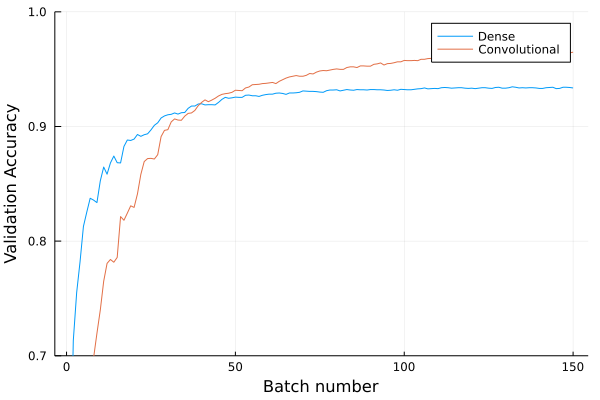

In [155]:
fix_seed!()

epochs = 30

η = 5e-3 #learning rate
opt1, opt2 = ADAM(η), ADAM(η)

accuracyPaths = [[],[]]

accuracy(x, y, model) = mean(onecold(model(x)) .== onecold(y))
loss(x, y, model) = crossentropy(model(x), y)

cbF1() = begin
            acc = accuracy(first(validate_set)..., model1)
            print("$acc, ")
            push!(accuracyPaths[1],acc)
        end

cbF2() = begin
            acc = accuracy(first(validate_set)..., model2)
            print("$acc, ")
            push!(accuracyPaths[2],acc)
        end

model1(train_set[1][1]); model2(train_set[1][1])

for ep in 1:epochs
    print("\nEpoch $ep \n  Model 1 accuracy: ")
    Flux.train!((x,y)->loss(x,y,model1), params(model1), train_set, opt1, cb=cbF1)
    print("  Model 2 accuracy: ")
    Flux.train!((x,y)->loss(x,y,model2), params(model2), train_set, opt2, cb=cbF2)
end

println("\n\nFinal Model1 (Dense) accuracy = ", accuracy(first(validate_set)..., model1))
println("Final Model2 (Convolutional) accuracy = ", accuracy(first(validate_set)..., model2))

plot(accuracyPaths,label = ["Dense" "Convolutional"],
    ylim=(0.7,1.0), xlabel="Batch number", ylabel = "Validation Accuracy")

[home](#home)

## The End 

I hope you enjoyed the tutorial.

Many more of these types of examples + statistical background are at [statisticswithjulia.org](https://statisticswithjulia.org/).